# Overview of SERTO

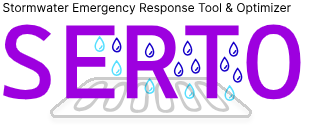

## History of the homeland project

- QGC HPC
- Sensor network/placement design (pregenerated probabilistic scenarios) versus resource/ multi-objective optimization (modifying model as it is executing)
- Expanding on work QGC
    - Consolidating analysis and visualization workflows
    - Improved scaling on HPC
    - EPA SWMM python bindings
        - Could be an opportunity to transition SWNTR to a tool cleared by EPA
        - Distinction SWNTR (Leave out until they talk about it)
            - Resilience oriented
            - Lack of multiobjective optimization and runtime interaction
            - Sensor placement not available
    - Multiples modes execution
        - Command line execution via
            - Template bash/bat files
            - Yaml/JSON configuration files
        - Through python package and API
        - Through python notebooks on personal, HPC, and cloud computing
- Workflow and highlight example outputs
- Clearance and rollout of the tool

## Workflow

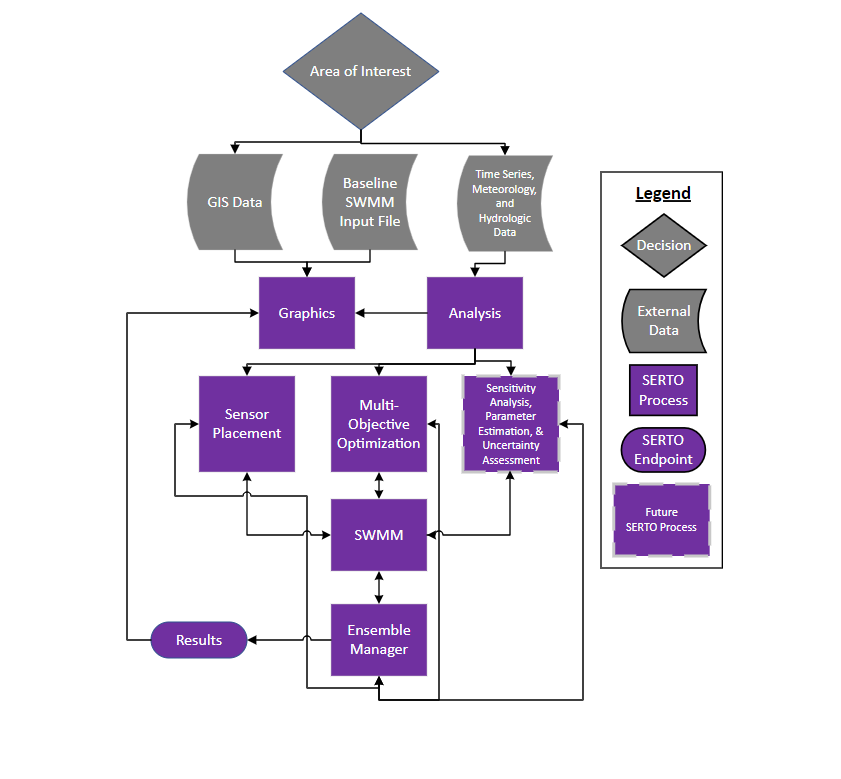

## Area of Interest

Define area of interest and understand the geographic setting of the study area using freely available geospatial datasets. Here, we use the National Hydrography Plus Dataset (NHDPlus) as an example. 

In [1]:
# python imports
import os 

# third-party imports
import plotly.offline as pyo
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
from serto.swmm import SpatialSWMM
from serto.graphics.swmm import *
import contextily as ctx
import matplotlib.pyplot as plt
import geopandas as gpd
import pandas as pd
import numpy as np
import plotly.figure_factory as ff

# local imports

Allow interactive plotly maps.

In [2]:
init_notebook_mode(connected=True)

In [42]:
DATA_DIR =  r'..\tests\data\licking'

fig = go.Figure()

minor_civil_divisions = gpd.read_file(os.path.join(DATA_DIR, 'GU_MinorCivilDivision_NKY.shp')).to_crs('EPSG:4326')
hydro_net_junctions = gpd.read_file(os.path.join(DATA_DIR, 'HYDRO_NET_Junctions_NKY.shp')).to_crs('EPSG:4326')
flow_lines = gpd.read_file(os.path.join(DATA_DIR, 'NHDFlowline_NKY.shp')).to_crs('EPSG:4326')
model_boundary = gpd.read_file(os.path.join(DATA_DIR, 'Subcatchments.shp')).to_crs('EPSG:4326')

# flow lines where gnis_name is not null
flow_lines = flow_lines[flow_lines['gnis_name'].notnull()]

flow_lines.head(10)

# Extract lat and lon from geometry
hydro_net_junctions['Latitude'] = hydro_net_junctions.geometry.y
hydro_net_junctions['Longitude'] = hydro_net_junctions.geometry.x

# Center map on centroid of nodes
minor_civil_divisions_centroid = minor_civil_divisions.dissolve().centroid
lon = minor_civil_divisions_centroid.geometry.x[0]
lat = minor_civil_divisions_centroid.geometry.y[0]

minor_civil_divisions_geo = minor_civil_divisions.drop(columns='geometry')
hydro_net_junctions_geo = hydro_net_junctions.drop(columns='geometry')
flow_lines_geo = flow_lines.drop(columns='geometry')
model_boundary_geo = model_boundary.drop(columns='geometry')
eligible_columns = model_boundary_geo.columns[:20]
model_boundary_geo = model_boundary_geo[eligible_columns]

fig.add_trace(
    go.Choroplethmap(
        name='Minor Civil Divisions',
        geojson=minor_civil_divisions.__geo_interface__,
        locations=minor_civil_divisions.index,
        z=[1] * len(minor_civil_divisions),
        colorscale=[[0, 'salmon'], [1, 'salmon']],
        hovertemplate='<br>'.join([
            f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(minor_civil_divisions_geo.columns)
        ]),
        text=minor_civil_divisions_geo['gnis_name'],
        customdata=minor_civil_divisions_geo.values,
        marker_opacity=0.25,
        marker_line_width=2,
        showscale=False,
        showlegend=True,
    )
)

# fig.add_trace(
#     go.Scattermap(
#         name='Hydro Net Junctions',
#         lon=hydro_net_junctions_geo['Longitude'],
#         lat=hydro_net_junctions_geo['Latitude'],
#         mode='markers',
#         marker=dict(
#             size=3.0,
#             color='gray',
#             # opacity=0.5
#         ),
#         hovertemplate='<br>'.join([
#             f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(hydro_net_junctions_geo.columns)
#         ]),
#         customdata=hydro_net_junctions_geo.values,
#     )
# )
fig.add_trace(
    go.Choroplethmap(
        name='SWMM Model Subcatchments',
        geojson=model_boundary.__geo_interface__,
        locations=model_boundary.index,
        z=[1] * len(model_boundary),
        colorscale=[[0, 'gray'], [1, 'gray']],
        hovertemplate='<br>'.join([
            f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(model_boundary_geo.columns[:16])
        ]),
        text=model_boundary_geo['NAME'],
        customdata=model_boundary_geo.values[:16],
        marker_opacity=0.25,
        marker_line_width=2,
        showscale=False,
        showlegend=True,
    )
)

first = True
link_traces = []

for index, row in flow_lines.iterrows():
    new_row = flow_lines_geo.loc[index]
    geometry = row['geometry']
    link_traces.append(
        go.Scattermap(
            name="Flow Lines",
            lon=[coord[0] for coord in geometry.coords],
            lat=[coord[1] for coord in geometry.coords],
            mode='lines',
            line=dict(
                width=2, 
                color='blue'
            ),
            hovertemplate='<br>'.join([
                f'<b>{col}</b>: %{{customdata[{i}]}}' for i, col in enumerate(new_row.index)
            ]),
            customdata=new_row.values,
            showlegend=first,
            legendgroup='flow_lines',
        )       
    )

    first = False

fig.add_traces(link_traces)

fig.update_layout(
    title=f'Area of Interest',
    map_style="carto-positron",
    showlegend=True,
    width=1200,
    height=600,
    map = {
        'center': {'lon': lon, 'lat': lat},
        'zoom': 9
    }
)

fig.show()

c:\Users\CBUAHIN\AppData\Local\miniforge3\envs\chama39\lib\site-packages\pyogrio\raw.py:196: UserWarning:

Measured (M) geometry types are not supported. Original type 'Measured 3D LineString' is converted to 'LineString Z'

C:\Users\CBUAHIN\AppData\Local\Temp\ipykernel_27500\921776168.py:20: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




## Weather Analysis Summarization

Plotting times to weather data to identify gaps and potential anomalies for remediation.



### Rainfall data

Plot rainfall timeseries data and heat map to identify potential gaps.

In [5]:
rainfall_data_path = r'..\tests\analysis\precipitation\cvg_precip.csv'
rainfall_data = pd.read_csv(rainfall_data_path, index_col=0, parse_dates=True)['2005-01-01':].resample(pd.Timedelta(minutes=60)).sum()

rainfall_figure = go.Figure()
for column in rainfall_data.columns:
    rainfall_figure.add_trace(
        go.Scattergl(
            x=rainfall_data.index,
            y=rainfall_data[column],
            mode='lines',
            line=dict(
            ),
            marker=dict(),
            name=column
        )       
    )

rainfall_figure.update_layout(
    title='Rainfall Data',
    xaxis_title='Time',
    yaxis_title='Rainfall (inches)',
    width=1200,
    height=600,
    xaxis=dict(
        rangeslider=dict(visible=True),
    ),
    showlegend=True
)

rainfall_figure.show()

### Wind Data 

Plot wind time series

In [6]:
wind_data_path = r'..\tests\analysis\wind\wind_data.csv'
wind_data = pd.read_csv(
    wind_data_path,
    index_col="TimeEST",
    parse_dates=["TimeEST"]
    )['2005-01-01':]

wind_data = wind_data.drop(columns=['station', 'station_name'])
# Reample monthly
wind_data = wind_data.resample('ME').mean()

wind_data['u'] = wind_data['sknt'] * np.cos(np.radians(wind_data['drct']))
wind_data['v'] = wind_data['sknt'] * np.sin(np.radians(wind_data['drct']))
wind_data['r'] = np.sqrt(wind_data['u']**2 + wind_data['v']**2)

# numeric timestamps in milliseconds
x = wind_data.index.astype(int) // 10**6
scale_ratio = (x.max() - x.min()) / (wind_data['r'].max() - wind_data['r'].min())

wind_fig = ff.create_quiver(
    x = x,
    y = np.zeros(len(wind_data)),
    u = wind_data['u'],
    v = wind_data['v'],
    scale = 0.05,
    arrow_scale=0.25,
    angle=np.pi/18,
    scaleratio=scale_ratio,
    name='CVG ',
    line=dict(
        width=3,
        color='blue'
    ),
)
empty = go.Scatter(
        x=wind_data.index,
        y=np.zeros(len(wind_data)),
        mode='markers',
        name='Wind Speed',
        showlegend=False,
        marker=dict(
            color='blue',
            size=6,
        ),
        visible=True,
)

wind_fig = go.Figure(data=[empty, *wind_fig.data])

wind_fig.update_layout(
    title='Wind Data',
    width=1200,
    height=600,
    showlegend=True,
    yaxis_title='Wind Speed (knots)',
    xaxis_title='Time',
)

wind_fig.update_xaxes(
    showgrid=False,
    # tickformat="%d.%m.%Y",
)

wind_fig.update_yaxes(
    showgrid=False,
)

wind_fig.show()

## Data Analysis

Various analysis tools for analyzing weather and hydrologic timeseries datasets are available.

### Rainfall Events Summary

For rainfall, users can extract events, calculate return periods, sample from events, and extract return period information automatically from NOAA Atlas 14 and in the future from NOAA Atlas 15.

Extract rainfall events using SERTO

In [7]:
from serto.analysis.precipitation import PrecipitationAnalysis
from serto.graphics.analysis.precipitation import PrecipitationVisualization


events = PrecipitationAnalysis.get_events(
    rainfall=rainfall_data,
    inter_event_time=pd.Timedelta(days=1),
    floor=1.0E-13
)

events.head(10)



,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total
0,2005Jan01T01,2005-01-01 01:00:00,2005-01-02 04:00:00,2005-01-01 04:00:00,0 days 03:00:00,1 days 18:00:00,0 days 01:00:00,0.02,0.02
1,2005Jan02T22,2005-01-02 22:00:00,2005-01-07 07:00:00,2005-01-06 07:00:00,3 days 09:00:00,1 days 13:00:00,1 days 18:00:00,0.37,4.37
2,2005Jan07T20,2005-01-07 20:00:00,2005-01-09 03:00:00,2005-01-08 03:00:00,0 days 07:00:00,2 days 22:00:00,1 days 13:00:00,0.10,0.34
3,2005Jan11T01,2005-01-11 01:00:00,2005-01-12 19:00:00,2005-01-11 19:00:00,0 days 18:00:00,1 days 08:00:00,2 days 22:00:00,0.11,0.43
4,2005Jan13T03,2005-01-13 03:00:00,2005-01-14 19:00:00,2005-01-13 19:00:00,0 days 16:00:00,4 days 17:00:00,1 days 08:00:00,0.15,0.42
5,2005Jan18T12,2005-01-18 12:00:00,2005-01-19 12:00:00,2005-01-18 12:00:00,0 days 00:00:00,1 days 22:00:00,4 days 17:00:00,0.01,0.01
6,2005Jan20T10,2005-01-20 10:00:00,2005-01-21 22:00:00,2005-01-20 22:00:00,0 days 12:00:00,1 days 08:00:00,1 days 22:00:00,0.06,0.32
7,2005Jan22T06,2005-01-22 06:00:00,2005-01-23 06:00:00,2005-01-22 06:00:00,0 days 00:00:00,7 days 00:00:00,1 days 08:00:00,0.01,0.01
8,2005Jan29T06,2005-01-29 06:00:00,2005-01-30 23:00:00,2005-01-29 23:00:00,0 days 17:00:00,3 days 19:00:00,7 days 00:00:00,0.09,0.40
9,2005Feb02T18,2005-02-02 18:00:00,2005-02-04 07:00:00,2005-02-03 07:00:00,0 days 13:00:00,2 days 05:00:00,3 days 19:00:00,0.03,0.13


Chama allows integration of event probabilities and so getting return period information from NOAA Atlas 14 webservice.

In [43]:
events = PrecipitationAnalysis.get_event_attributes(
    events=events,
    latitude=39.049774180652236,
    longitude=-84.66127045790225,
    series='ams'
)

events.head(10)


c:\Users\CBUAHIN\AppData\Local\miniforge3\envs\chama39\lib\site-packages\urllib3\connectionpool.py:1099: InsecureRequestWarning:

Unverified HTTPS request is being made to host 'hdsc.nws.noaa.gov'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings

c:\Users\CBUAHIN\AppData\Local\miniforge3\envs\chama39\lib\site-packages\urllib3\connectionpool.py:1099: InsecureRequestWarning:

Unverified HTTPS request is being made to host 'hdsc.nws.noaa.gov'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings

C:\Users\CBUAHIN\SourceCodes\DigitalWaterAnalytics\SERTO\serto\analysis\precipitation\precipitation.py:109: ParserWarning:

Falling back to the 'python' engine because the 'c' engine does not support skipfooter; you can avoid this warning by specifying engine='python'.



,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total,return_period,duration_hours,cluster
0,2005Jan01T01,2005-01-01 01:00:00,2005-01-02 04:00:00,2005-01-01 04:00:00,0 days 03:00:00,1 days 18:00:00,0 days 01:00:00,0.02,0.02,0.02454,3.0,4
1,2005Jan02T22,2005-01-02 22:00:00,2005-01-07 07:00:00,2005-01-06 07:00:00,3 days 09:00:00,1 days 13:00:00,1 days 18:00:00,0.37,4.37,4.634518,81.0,1
2,2005Jan07T20,2005-01-07 20:00:00,2005-01-09 03:00:00,2005-01-08 03:00:00,0 days 07:00:00,2 days 22:00:00,1 days 13:00:00,0.10,0.34,0.331169,7.0,4
3,2005Jan11T01,2005-01-11 01:00:00,2005-01-12 19:00:00,2005-01-11 19:00:00,0 days 18:00:00,1 days 08:00:00,2 days 22:00:00,0.11,0.43,0.337255,18.0,0
4,2005Jan13T03,2005-01-13 03:00:00,2005-01-14 19:00:00,2005-01-13 19:00:00,0 days 16:00:00,4 days 17:00:00,1 days 08:00:00,0.15,0.42,0.337349,16.0,0
5,2005Jan18T12,2005-01-18 12:00:00,2005-01-19 12:00:00,2005-01-18 12:00:00,0 days 00:00:00,1 days 22:00:00,4 days 17:00:00,0.01,0.01,0.047847,0.0,4
6,2005Jan20T10,2005-01-20 10:00:00,2005-01-21 22:00:00,2005-01-20 22:00:00,0 days 12:00:00,1 days 08:00:00,1 days 22:00:00,0.06,0.32,0.270042,12.0,4
7,2005Jan22T06,2005-01-22 06:00:00,2005-01-23 06:00:00,2005-01-22 06:00:00,0 days 00:00:00,7 days 00:00:00,1 days 08:00:00,0.01,0.01,0.047847,0.0,4
8,2005Jan29T06,2005-01-29 06:00:00,2005-01-30 23:00:00,2005-01-29 23:00:00,0 days 17:00:00,3 days 19:00:00,7 days 00:00:00,0.09,0.40,0.31746,17.0,0
9,2005Feb02T18,2005-02-02 18:00:00,2005-02-04 07:00:00,2005-02-03 07:00:00,0 days 13:00:00,2 days 05:00:00,3 days 19:00:00,0.03,0.13,0.108333,13.0,4


Clustering rainfall events by total, peak, and duration

In [9]:
events['duration_hours'] = events['duration'] / pd.Timedelta(hours=1)

events = PrecipitationAnalysis.cluster_events(
    events=events,
    cluster_columns=['precip_total', 'precip_peak', 'duration_hours'],
    number_of_clusters=6,
)

events.head(10)



,name,start,end,actual_end,duration,post_event_time,antecedent_event_time,precip_peak,precip_total,return_period,duration_hours,cluster
0,2005Jan01T01,2005-01-01 01:00:00,2005-01-02 04:00:00,2005-01-01 04:00:00,0 days 03:00:00,1 days 18:00:00,0 days 01:00:00,0.02,0.02,0.02454,3.0,4
1,2005Jan02T22,2005-01-02 22:00:00,2005-01-07 07:00:00,2005-01-06 07:00:00,3 days 09:00:00,1 days 13:00:00,1 days 18:00:00,0.37,4.37,4.634518,81.0,1
2,2005Jan07T20,2005-01-07 20:00:00,2005-01-09 03:00:00,2005-01-08 03:00:00,0 days 07:00:00,2 days 22:00:00,1 days 13:00:00,0.10,0.34,0.331169,7.0,4
3,2005Jan11T01,2005-01-11 01:00:00,2005-01-12 19:00:00,2005-01-11 19:00:00,0 days 18:00:00,1 days 08:00:00,2 days 22:00:00,0.11,0.43,0.337255,18.0,0
4,2005Jan13T03,2005-01-13 03:00:00,2005-01-14 19:00:00,2005-01-13 19:00:00,0 days 16:00:00,4 days 17:00:00,1 days 08:00:00,0.15,0.42,0.337349,16.0,0
5,2005Jan18T12,2005-01-18 12:00:00,2005-01-19 12:00:00,2005-01-18 12:00:00,0 days 00:00:00,1 days 22:00:00,4 days 17:00:00,0.01,0.01,0.047847,0.0,4
6,2005Jan20T10,2005-01-20 10:00:00,2005-01-21 22:00:00,2005-01-20 22:00:00,0 days 12:00:00,1 days 08:00:00,1 days 22:00:00,0.06,0.32,0.270042,12.0,4
7,2005Jan22T06,2005-01-22 06:00:00,2005-01-23 06:00:00,2005-01-22 06:00:00,0 days 00:00:00,7 days 00:00:00,1 days 08:00:00,0.01,0.01,0.047847,0.0,4
8,2005Jan29T06,2005-01-29 06:00:00,2005-01-30 23:00:00,2005-01-29 23:00:00,0 days 17:00:00,3 days 19:00:00,7 days 00:00:00,0.09,0.40,0.31746,17.0,0
9,2005Feb02T18,2005-02-02 18:00:00,2005-02-04 07:00:00,2005-02-03 07:00:00,0 days 13:00:00,2 days 05:00:00,3 days 19:00:00,0.03,0.13,0.108333,13.0,4


In [ ]:

fig = px.scatter_matrix(
    events,
    dimensions=cluster_columns,
    color='cluster_label',
    title='Precipitation Event Clustering',
    diagonal='histogram',
)

fig.update_layout(
    width=1200,
    height=600,
)

fig.show()

TypeError: scatter_matrix() got an unexpected keyword argument 'diagonal'

In [46]:
precip_figures = PrecipitationVisualization.plot_precipitation(
    events=events,
    precipitation=rainfall_data,
)
for precip_figure in precip_figures:
    precip_figure.show()

ValueError: 
    Invalid value of type 'pandas.core.series.Series' received for the 'width' property of bar
        Received value: 0      0 days 03:00:00
1      3 days 09:00:00
2      0 days 07:00:00
3      0 days 18:00:00
4      0 days 16:00:00
             ...      
1501   1 days 23:00:00
1502   0 days 07:00:00
1503   4 days 10:00:00
1504   0 days 18:00:00
1505   3 days 02:00:00
Name: duration, Length: 1506, dtype: timedelta64[ns]

    The 'width' property is a number and may be specified as:
      - An int or float in the interval [0, inf]
      - A tuple, list, or one-dimensional numpy array of the above

### Wind Speed and Direction Analysis

In [17]:
wind_data.head(10)

,sknt,drct,u,v,r
TimeEST,,,,,
2005-01-31,8.393007,180.198601,-8.392957,-0.029092,8.393007
2005-02-28,7.697744,193.864662,-7.473466,-1.844605,7.697744
2005-03-31,8.466867,184.593373,-8.439673,-0.678058,8.466867
2005-04-30,8.791411,174.082822,-8.744570,0.906313,8.791411
2005-05-31,6.851351,192.671171,-6.684487,-1.502880,6.851351
2005-06-30,5.909774,152.240602,-5.229626,2.752535,5.909774
2005-07-31,6.385768,179.801498,-6.385729,0.022124,6.385768
2005-08-31,5.859972,167.973126,-5.731345,1.221045,5.859972
2005-09-30,5.343333,183.493333,-5.333405,-0.325582,5.343333


## SWMM Model Network

In [11]:
swmm_spatial_model = SpatialSWMM.read_model(
    model_path='../tests/spatialswmm/swmm/test_model.inp',
    crs='EPSG:3089'
)

fig = go.Figure()

# Retrieve traces for catchments, links, and nodes
catchment_traces = SpatialSWMMVisualization.plot_catchments_plotly(swmm_spatial_model)
link_traces = SpatialSWMMVisualization.plot_links_plotly(swmm_spatial_model)
node_traces = SpatialSWMMVisualization.plot_nodes_plotly(swmm_spatial_model)

# Center map on centroid of nodes
nodes_centroid = swmm_spatial_model.nodes.dissolve().centroid.to_crs('EPSG:4326')
lon = nodes_centroid.geometry.x[0]
lat = nodes_centroid.geometry.y[0]

for catchment_trace in catchment_traces:
    fig.add_trace(catchment_trace)

for node_trace in node_traces:
    fig.add_trace(node_trace)

fig.update_layout(
    title=f'',
    map_style="carto-positron",
    showlegend=True,
    width=1600,
    height=800,
    map = {
        'center': {'lon': lon, 'lat': lat},
        'zoom': 10
    }
)

fig.show()

## Hypothetical Plumes

In [ ]:
from serto.analysis.plumes import GaussianPlumeAnalysis